In [15]:
new_coordinates=[(-37.790554602224425, 144.90463157719853),
(-37.79208408235216, 144.90617704983697),
(-37.79373476005093, 144.91191373365075),
(-37.793234155968776, 144.91556442375926),
(-37.79050160844402, 144.92012784083755),
(-37.78879343377509, 144.92041228976655),
(-37.787615194961276, 144.91999436816096),
(-37.78617060021667, 144.9197891178724),
(-37.786737240462756, 144.9132334640103),
(-37.78750735341219, 144.9103469800788),
(-37.78843280266367, 144.90612877678566)]

formatted_locations = [f"{coord[0]}, {coord[1]}" for coord in new_coordinates]
formatted_locations_str = "\n".join(formatted_locations)
# locations = st.text_area("Coordinates:", value=formatted_locations_str)
user_coordinates = [tuple(map(float, location.split(','))) for location in formatted_locations_str.split('\n') if formatted_locations_str]
total_lat = 0
total_lon = 0
num_vertices = len(user_coordinates)

for vertex in user_coordinates:
    total_lat += vertex[0]
    total_lon += vertex[1]

decimal_places=2
value=10**(-decimal_places)
center_lat = total_lat / num_vertices
center_lon = total_lon / num_vertices
center=(center_lat,center_lon)
lower_lat = round((int(center_lat * 10**decimal_places) / 10**decimal_places)-value,decimal_places)
upper_lat = round((int(center_lat * 10**decimal_places) / 10**decimal_places)+value,decimal_places)
lower_lon = round((int(center_lon * 10**decimal_places) / 10**decimal_places)-value,decimal_places)
upper_lon = round((int(center_lon * 10**decimal_places) / 10**decimal_places)+value,decimal_places) 

print(lower_lat)
print(upper_lat)
print(lower_lon)
print(upper_lon)


-37.79
-37.77
144.9
144.92


In [11]:
center

(-37.78957871223018, 144.91348360199618)

In [5]:
import random
import math
import csv

# Function to generate random points within a circle of radius 1 km
def generate_random_points(latitude, longitude, num_points):
    points = []
    for _ in range(num_points):
        # Generate random angle
        theta = random.uniform(0, 2 * math.pi)
        # Generate random distance within 1 km
        r = math.sqrt(random.uniform(0, 0.0003))
        # Calculate new latitude and longitude
        new_latitude = latitude + (r * math.cos(theta)) / 111.32
        new_longitude = longitude + (r * math.sin(theta)) / (111.32 * math.cos(latitude))
        points.append((new_latitude, new_longitude))
    return points

# Given latitude and longitude
latitude = -37.8760082603777
longitude = 145.03630138455543

# Number of points to generate
num_points = 3000

# Generate random points within 1 km radius
random_points = generate_random_points(math.radians(latitude), math.radians(longitude), num_points)

# Convert back to degrees
random_points_degrees = [(math.degrees(point[0]), math.degrees(point[1])) for point in random_points]

# Write the random points to a CSV file
with open('random_points.csv', 'w', newline='') as csvfile:
    writer = csv.writer(csvfile)
    writer.writerow(['latitude', 'longitude'])
    for point in random_points_degrees:
        writer.writerow(point)


In [ ]:
filtered_coordinates = {}


industry_list = ['latitude', 'longitude', 'Radius','Location']
user_coordinates = []

default_values = [[-33.864201, 151.21644, 30.0,'Royal Botanic Garden'], [-33.8471, 151.0634, 11.0,'Accor Stadium'], [-33.866159, 151.215256, 28.0,'Sydney Opera House'], [-33.8833, 151.2050, 22.0,'Central Station'], [-33.893000, 151.215000, 21.0,'Monash University']]

for idx in range(no_of_locations):
    location_data = []
    row = st.columns(4)

    # Get the default values for the current location
    default_value = default_values[idx] if idx < len(default_values) else [0.0, 0.0, 0.0,'']

    for i, industry in enumerate(industry_list):
        if industry == 'Location':
            # Display the location identifier separately
            location_identifier = row[i].text_input(f"{industry} - Location {idx + 1}", value=default_value[i])
            
        else:
            # Display numeric fields for latitude, longitude, and radius
            value = row[i].number_input(f"{industry} - Location {idx + 1}", format="%.6f", value=default_value[i])
            location_data.append(value)

    # Append the location identifier to the location data
    location_data.append(location_identifier)
    user_coordinates.append(location_data)
# st.write(user_coordinates)
if len(user_coordinates[0]) ==4:
    for user_lat, user_lon, radius_input,_ in user_coordinates:

        filtered_coordinates[(user_lat, user_lon)] = []


    for index, row in df.iterrows():
        for user_lat, user_lon, radius,_ in user_coordinates:
            distance = haversine(user_lat, user_lon, row['latitude'], row['longitude'])


            if dist == 'Meters':
                radius= radius/1000

            if distance <= radius:
                count_within_radius[(user_lat, user_lon)] += 1
                filtered_coordinates[(user_lat, user_lon)].append((row['latitude'], row['longitude']))

In [96]:
from pyspark.sql import SparkSession

# Create a SparkSession
spark = SparkSession.builder \
    .appName("YourAppName") \
    .config("spark.some.config.option", "some-value") \
    .getOrCreate()


# Read CSV file
df = spark.read.csv("../../geolocation/backup/Sample_Movement_data.csv", header=True, inferSchema=True)

# Show DataFrame
df.show(5)

+--------------------+-------------------+------------+------------+-----------+------------+--------------------+--------------------+--------------------+--------------------+---------+------+-------------------+---------+
|                maid|      datetimestamp|    latitude|   longitude|workgeohash|homegeohash9|           interests|      brands_visited|    place_categories|        geobehaviour|OCCURENCE|Gender|             Income|Age_Range|
+--------------------+-------------------+------------+------------+-----------+------------+--------------------+--------------------+--------------------+--------------------+---------+------+-------------------+---------+
|0003ff5a-b1e2-42e...|2023-12-21 07:18:50|    -34.9318|   138.59442|    r1fdstu|   r1fdh3636|Technology & Comp...|Chemist Warehouse...|Motels Visitors|C...|In-Market Insuran...|        1|     F|$104,000 - $155,999|    40-44|
|0003ff5a-b1e2-42e...|2023-12-18 12:24:14|    -34.7998|   138.69139|    r1fdstu|   r1fdh3636|Technol

In [97]:
df.select(['maid','datetimestamp','latitude','longitude','workgeohash','homegeohash9']).show(5)

+--------------------+-------------------+------------+------------+-----------+------------+
|                maid|      datetimestamp|    latitude|   longitude|workgeohash|homegeohash9|
+--------------------+-------------------+------------+------------+-----------+------------+
|0003ff5a-b1e2-42e...|2023-12-21 07:18:50|    -34.9318|   138.59442|    r1fdstu|   r1fdh3636|
|0003ff5a-b1e2-42e...|2023-12-18 12:24:14|    -34.7998|   138.69139|    r1fdstu|   r1fdh3636|
|0003ff5a-b1e2-42e...|2023-12-21 07:19:49|   -34.93458|   138.59653|    r1fdstu|   r1fdh3636|
|0003ff5a-b1e2-42e...|2023-12-18 07:37:47|    -34.7998|   138.69153|    r1fdstu|   r1fdh3636|
|0006c368-053f-492...|2023-12-19 02:41:03|-33.82111123|151.15903561|    r3gx29u|   r65gdv2v2|
+--------------------+-------------------+------------+------------+-----------+------------+
only showing top 5 rows



In [98]:
from pyspark.sql.functions import year, month, dayofmonth, dayofweek, hour

# Assuming 'datetimestamp' is the name of your timestamp column
df = df.withColumn('year', year('datetimestamp')) \
       .withColumn('month', month('datetimestamp')) \
       .withColumn('day', dayofmonth('datetimestamp')) \
       .withColumn('day_of_week', dayofweek('datetimestamp')) \
       .withColumn('hour', hour('datetimestamp'))

# Select the columns you want to show
df.select(['maid', 'year', 'month', 'day', 'day_of_week', 'hour', 'latitude', 'longitude', 'workgeohash', 'homegeohash9']).show(5)


+--------------------+----+-----+---+-----------+----+------------+------------+-----------+------------+
|                maid|year|month|day|day_of_week|hour|    latitude|   longitude|workgeohash|homegeohash9|
+--------------------+----+-----+---+-----------+----+------------+------------+-----------+------------+
|0003ff5a-b1e2-42e...|2023|   12| 21|          5|   7|    -34.9318|   138.59442|    r1fdstu|   r1fdh3636|
|0003ff5a-b1e2-42e...|2023|   12| 18|          2|  12|    -34.7998|   138.69139|    r1fdstu|   r1fdh3636|
|0003ff5a-b1e2-42e...|2023|   12| 21|          5|   7|   -34.93458|   138.59653|    r1fdstu|   r1fdh3636|
|0003ff5a-b1e2-42e...|2023|   12| 18|          2|   7|    -34.7998|   138.69153|    r1fdstu|   r1fdh3636|
|0006c368-053f-492...|2023|   12| 19|          3|   2|-33.82111123|151.15903561|    r3gx29u|   r65gdv2v2|
+--------------------+----+-----+---+-----------+----+------------+------------+-----------+------------+
only showing top 5 rows



In [94]:
from pyspark.sql.functions import when
from pyspark.sql.functions import col, desc, count

# Define a list of day names
day_names = ['Sunday', 'Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday']

# Add a new column for day names based on the day of the week
df = df.withColumn('day_name', when(df.day_of_week == 1, 'Sunday')
                                .when(df.day_of_week == 2, 'Monday')
                                .when(df.day_of_week == 3, 'Tuesday')
                                .when(df.day_of_week == 4, 'Wednesday')
                                .when(df.day_of_week == 5, 'Thursday')
                                .when(df.day_of_week == 6, 'Friday')
                                .when(df.day_of_week == 7, 'Saturday'))

# Add a new column for day type (weekday or weekend)
df = df.withColumn('day_type', 
                   when((df.day_of_week <= 5) & (df.day_of_week > 1), 'Weekday')
                   .otherwise('Weekend'))

# Show the updated DataFrame
df.select(['maid', 'year', 'month', 'day', 'day_name', 'day_type', 'hour', 'latitude', 'longitude', 'workgeohash', 'homegeohash9']).show(5)


+--------------------+----+-----+---+--------+--------+----+------------+------------+-----------+------------+
|                maid|year|month|day|day_name|day_type|hour|    latitude|   longitude|workgeohash|homegeohash9|
+--------------------+----+-----+---+--------+--------+----+------------+------------+-----------+------------+
|0003ff5a-b1e2-42e...|2023|   12| 21|Thursday| Weekday|   7|    -34.9318|   138.59442|    r1fdstu|   r1fdh3636|
|0003ff5a-b1e2-42e...|2023|   12| 18|  Monday| Weekday|  12|    -34.7998|   138.69139|    r1fdstu|   r1fdh3636|
|0003ff5a-b1e2-42e...|2023|   12| 21|Thursday| Weekday|   7|   -34.93458|   138.59653|    r1fdstu|   r1fdh3636|
|0003ff5a-b1e2-42e...|2023|   12| 18|  Monday| Weekday|   7|    -34.7998|   138.69153|    r1fdstu|   r1fdh3636|
|0006c368-053f-492...|2023|   12| 19| Tuesday| Weekday|   2|-33.82111123|151.15903561|    r3gx29u|   r65gdv2v2|
+--------------------+----+-----+---+--------+--------+----+------------+------------+-----------+------

In [95]:
df_mov=df.select(['maid', 'year', 'month', 'day', 'day_name', 'day_type', 'hour', 'latitude', 'longitude', 'workgeohash', 'homegeohash9']).orderBy(col('maid'),col('day'),col('hour'))
df_mov.show(5,truncate=False)

+------------------------------------+----+-----+---+--------+--------+----+------------+------------+-----------+------------+
|maid                                |year|month|day|day_name|day_type|hour|latitude    |longitude   |workgeohash|homegeohash9|
+------------------------------------+----+-----+---+--------+--------+----+------------+------------+-----------+------------+
|0003ff5a-b1e2-42ee-9b14-01be4a1fe09c|2023|12   |18 |Monday  |Weekday |7   |-34.7998    |138.69153   |r1fdstu    |r1fdh3636   |
|0003ff5a-b1e2-42ee-9b14-01be4a1fe09c|2023|12   |18 |Monday  |Weekday |12  |-34.7998    |138.69139   |r1fdstu    |r1fdh3636   |
|0003ff5a-b1e2-42ee-9b14-01be4a1fe09c|2023|12   |21 |Thursday|Weekday |7   |-34.9318    |138.59442   |r1fdstu    |r1fdh3636   |
|0003ff5a-b1e2-42ee-9b14-01be4a1fe09c|2023|12   |21 |Thursday|Weekday |7   |-34.93458   |138.59653   |r1fdstu    |r1fdh3636   |
|0006c368-053f-492c-9986-f1c8f9e5181d|2023|12   |19 |Tuesday |Weekday |0   |-33.81971455|151.16508662|r3

#### Frequent Visiting 

In [8]:
from pyspark.sql.functions import col, desc, count

df1=df_mov.groupBy(['maid','day']).agg(count('*').alias('count')).orderBy(desc('count'))
df1.show(5)

+--------------------+---+-----+
|                maid|day|count|
+--------------------+---+-----+
|1ea3d490-b25f-4fc...| 18|    4|
|14dbe691-4749-499...| 18|    4|
|1c9f9ff8-b447-467...| 19|    4|
|0b54270d-04af-425...| 19|    4|
|0028f266-9072-452...| 19|    4|
+--------------------+---+-----+
only showing top 5 rows



In [10]:
df2=df1.select('maid').filter(col('count')>=2)

In [11]:
# Join df_mov with df2 on 'maid' column
joined_df = df_mov.join(df2, on='maid', how='left_semi')

# Show the joined DataFrame
joined_df.count()

96006

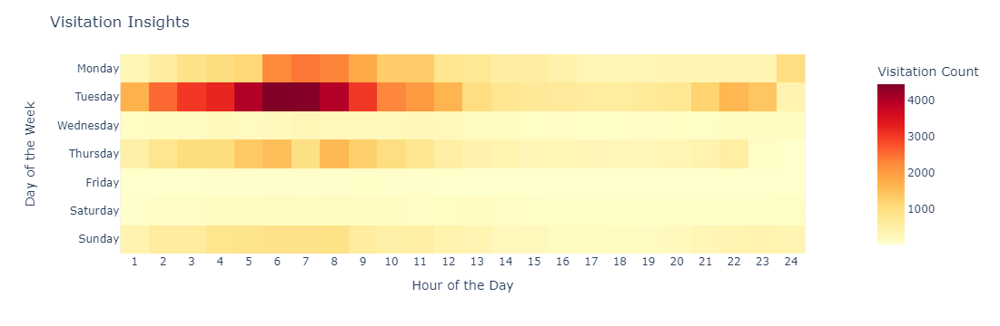

In [12]:
import plotly.express as px
import pandas as pd

# Assuming df is your Spark DataFrame containing the data
# For demonstration purposes, let's assume the DataFrame is named 'df'
# You need to replace 'df' with the actual name of your DataFrame

# Convert Spark DataFrame to Pandas DataFrame
pandas_df = df_mov.toPandas()

# Pivot the Pandas DataFrame to have days of the week as rows and hours as columns
heatmap_data = pandas_df.pivot_table(index='day_name', columns='hour', aggfunc='size')

# Reorder the rows of the heatmap data to match the order in the image
heatmap_data = heatmap_data.reindex(['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday'])

# Create the heatmap using Plotly Express
fig = px.imshow(heatmap_data,
                labels=dict(x="Hour of the Day", y="Day of the Week", color="Visitation Count"),
                x=['1', '2', '3', '4', '5', '6', '7', '8', '9', '10', '11', '12', '13', '14', '15', '16', '17', '18', '19', '20', '21', '22', '23', '24'],
                y=['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday'],
                color_continuous_scale="YlOrRd")

# Update layout
fig.update_layout(title='Visitation Insights',
                  xaxis_title='Hour of the Day',
                  yaxis_title='Day of the Week')

# Show the plot
fig.show()


C:\Users\tuanm\AppData\Local\Temp\ipykernel_8664\2017369928.py:13: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.



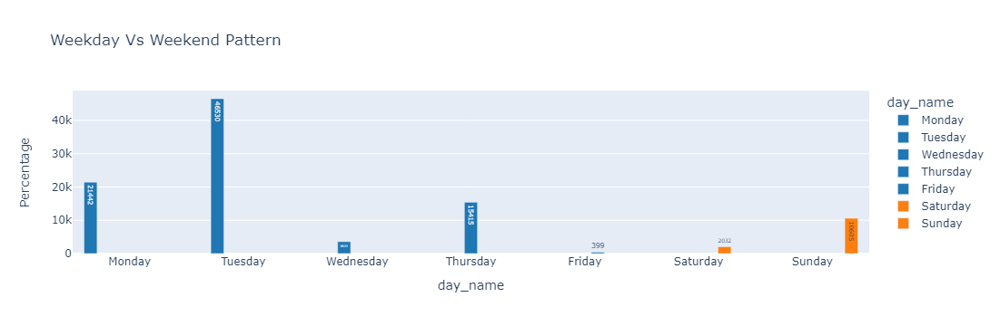

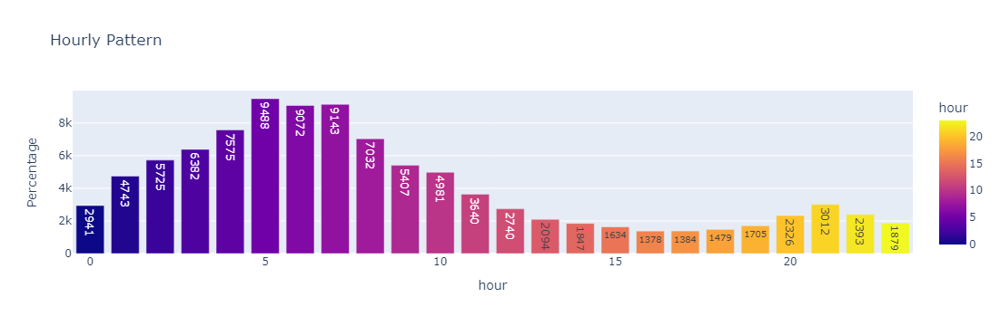

In [13]:

# Define colors for weekdays and weekends
colors = {'Monday': 'rgb(31, 119, 180)', 'Tuesday': 'rgb(31, 119, 180)', 'Wednesday': 'rgb(31, 119, 180)',
          'Thursday': 'rgb(31, 119, 180)', 'Friday': 'rgb(31, 119, 180)',
          'Saturday': 'rgb(255, 127, 14)', 'Sunday': 'rgb(255, 127, 14)'}

# Define the order of days according to the colors dictionary
# day_order = ['Monday', 'Friday', 'Saturday', 'Sunday', 'Thursday', 'Tuesday', 'Wednesday']

# Convert 'day_name' to categorical data type with specified order
pandas_df['day_name'] = pd.Categorical(pandas_df['day_name'], categories=list(colors.keys()), ordered=True)

# Create the bar chart for Weekday Vs Weekend Pattern
weekday_weekend_fig = px.bar(pandas_df.groupby('day_name').size().reset_index(name='count'), 
                             x='day_name', y='count', color='day_name',
                             color_discrete_map=colors, title='Weekday Vs Weekend Pattern',
                             labels={'count': 'Percentage'}, text='count')

# Update layout
weekday_weekend_fig.update_layout(barmode='group')
# Create the bar chart for Hourly Pattern
hourly_pattern_fig = px.bar(pandas_df.groupby('hour').size().reset_index(name='count'), 
                            x='hour', y='count', color='hour',
                            title='Hourly Pattern', labels={'count': 'Percentage'}, text='count')

# Update layout
hourly_pattern_fig.update_layout(barmode='group')

# Show the plots
weekday_weekend_fig.show()
hourly_pattern_fig.show()


In [18]:
from datetime import datetime

# Example: defining selected_start_date and selected_end_date
selected_start_date = datetime(2023, 12, 1)
selected_end_date = datetime(2023, 12, 31)

# Now you can use the code snippet to filter the DataFrame
start_timestamp = selected_start_date.strftime("2023-12-10")
end_timestamp = selected_end_date.strftime("2023-12-19")

# Filter the DataFrame based on the date range
filtered_df = df.filter((col('datetimestamp') >= start_timestamp) & (col('datetimestamp') <= end_timestamp))
filtered_df.count()

39119

In [19]:
from pyspark.sql import functions as F

user_input_lat = "-37.82968153089708"
user_input_lon = "145.05531534492368"

user_lat = float(user_input_lat)
user_lon = float(user_input_lon)

# Calculate the distance using the Haversine formula
distance = F.acos(
    F.sin(F.radians(F.lit(user_lat))) * F.sin(F.radians(filtered_df['latitude'])) +
    F.cos(F.radians(F.lit(user_lat))) * F.cos(F.radians(filtered_df['latitude'])) *
    F.cos(F.radians(filtered_df['longitude']) - F.radians(F.lit(user_lon)))
) * F.lit(6371.0)  # Earth radius in kilometers

# Filter the DataFrame based on the distance condition
filtered_df = filtered_df.withColumn('distance', distance)
count_within_radius = filtered_df.filter(filtered_df['distance'] <= 5).count()
count_within_radius_df = filtered_df.filter(filtered_df['distance'] <= 5)

count_within_radius

655

In [20]:
import folium
# Collect latitude and longitude values from the DataFrame
coordinates = filtered_df.select('latitude', 'longitude').collect()

# Create a Folium map centered at the first coordinate
# map_center = [coordinates[0]['latitude'], coordinates[0]['longitude']]
mymap = folium.Map(location=[user_lat, user_lon], zoom_start=10)


# Add markers for all coordinates to the map
for coord in coordinates:
    folium.CircleMarker(location=[coord['latitude'], coord['longitude']], radius=2, color='blue', fill=True, fill_color='blue',
                            fill_opacity=1).add_to(mymap)
folium.CircleMarker(location=[user_lat, user_lon], radius=4, color='red', fill=True, fill_color='red',
                        fill_opacity=1).add_to(mymap)
folium.Circle(
    location=(user_lat,user_lon),
    radius=5000,
    color='green',
    fill=True,
    fill_opacity=0.4,
    ).add_to(mymap)
# Display the map
mymap

In [22]:
count_within_radius_df.orderBy('maid').show()

+--------------------+-------------------+----------+---------+-----------+------------+--------------------+--------------------+--------------------+--------------------+---------+------+-------------------+---------+----+-----+---+-----------+----+--------+--------+------------------+
|                maid|      datetimestamp|  latitude|longitude|workgeohash|homegeohash9|           interests|      brands_visited|    place_categories|        geobehaviour|OCCURENCE|Gender|             Income|Age_Range|year|month|day|day_of_week|hour|day_name|day_type|          distance|
+--------------------+-------------------+----------+---------+-----------+------------+--------------------+--------------------+--------------------+--------------------+---------+------+-------------------+---------+----+-----+---+-----------+----+--------+--------+------------------+
|020bc715-32dc-43b...|2023-12-18 13:12:02|  -37.8405| 145.0639|    r1r0tp2|   r1r0tp2p2|Technology & Comp...|First Choice Liqu...|Cin

In [25]:
count_within_radius_df.groupBy(['maid']).agg(count('*').alias('count')).orderBy(desc('count')).show(5)

+--------------------+-----+
|                maid|count|
+--------------------+-----+
|020bc715-32dc-43b...|    4|
|4ff019ae-5760-4c6...|    4|
|33f25b15-0c13-47d...|    4|
|179530ab-c7b6-43b...|    4|
|370a42a7-08e6-433...|    4|
+--------------------+-----+
only showing top 5 rows



In [26]:
freq_day=count_within_radius_df.groupBy(['maid','day']).agg(count('*').alias('count')).orderBy(('count'))
freq_day.show(5)
freq_day.count()


+--------------------+---+-----+
|                maid|day|count|
+--------------------+---+-----+
|1a295aa0-b969-4ba...| 17|    1|
|161b150a-9d31-492...| 14|    1|
|1e790841-0942-4c5...| 14|    1|
|149d831d-7001-496...| 18|    1|
|131f215e-0587-4e9...| 18|    1|
+--------------------+---+-----+
only showing top 5 rows



454

C:\Users\tuanm\AppData\Local\Programs\Python\Python311\Lib\site-packages\pyspark\sql\pandas\types.py:563: FutureWarning:

is_datetime64tz_dtype is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.DatetimeTZDtype)` instead.

C:\Users\tuanm\AppData\Local\Programs\Python\Python311\Lib\site-packages\pyspark\sql\pandas\types.py:379: FutureWarning:

is_datetime64tz_dtype is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.DatetimeTZDtype)` instead.

C:\Users\tuanm\AppData\Local\Temp\ipykernel_8664\1996766999.py:41: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.



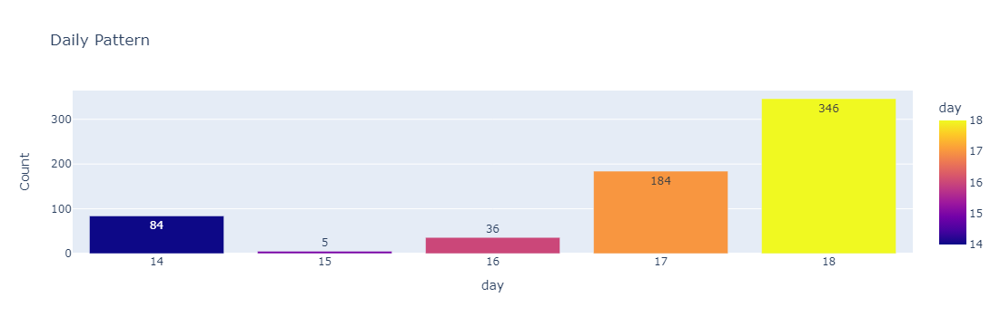

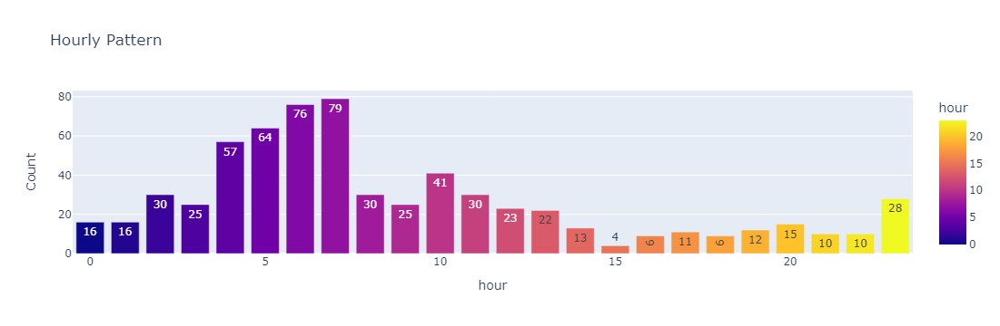

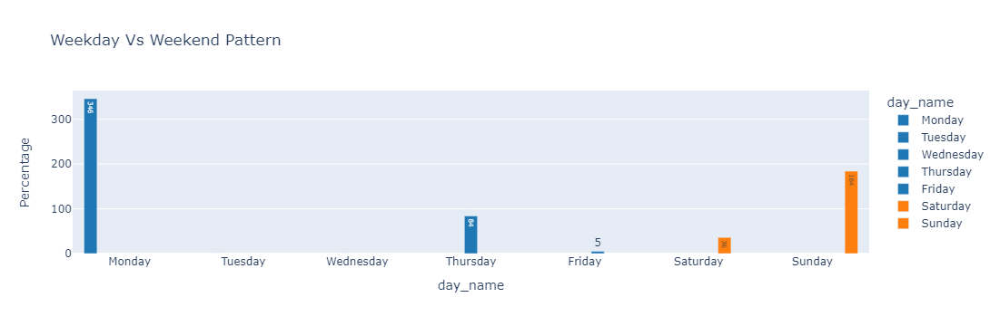

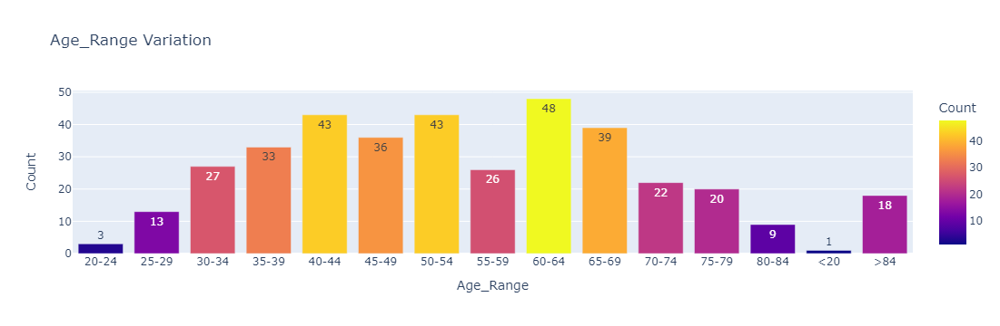

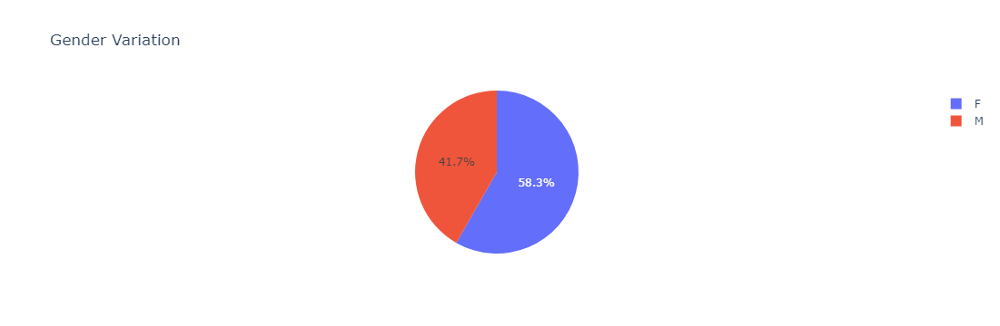

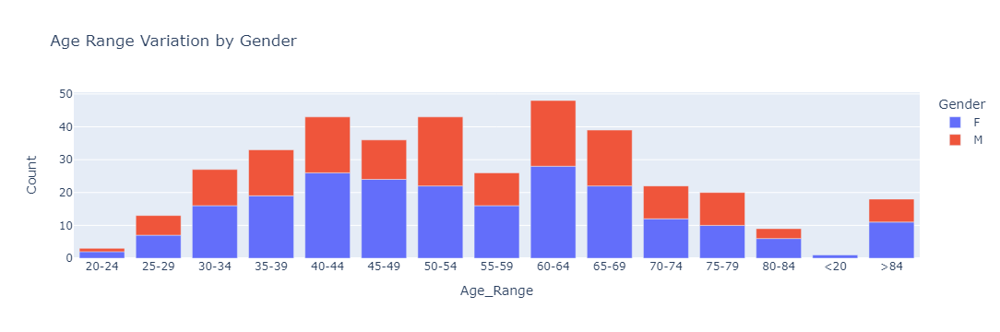

In [29]:
import plotly.express as px
import pandas as pd

# Assuming df is your Spark DataFrame containing the data
# For demonstration purposes, let's assume the DataFrame is named 'df'
# You need to replace 'df' with the actual name of your DataFrame

# Convert Spark DataFrame to Pandas DataFrame
pandas_df = count_within_radius_df.toPandas()

pandas_unique = pandas_df.drop_duplicates(subset=['maid'])

day_pattern_fig = px.bar(pandas_df.groupby(['day']).size().reset_index(name='count'), 
                            x='day', y='count', color='day',
                            title='Daily Pattern', labels={'count': 'Count'}, text='count')

hourly_pattern_fig = px.bar(pandas_df.groupby(['hour']).size().reset_index(name='count'), 
                            x='hour', y='count', color='hour',
                            title='Hourly Pattern', labels={'count': 'Count'}, text='count')
age_pattern_fig = px.bar(pandas_unique.groupby(['Age_Range']).size().reset_index(name='count'), 
                            x='Age_Range', y='count', color='count',
                            title='Age_Range Variation', labels={'count': 'Count'}, text='count')

gender_pattern_fig = px.pie(pandas_unique, names='Gender', title='Gender Variation')


# # # Update layout
day_pattern_fig.update_layout(barmode='group')

colors = {'Monday': 'rgb(31, 119, 180)', 'Tuesday': 'rgb(31, 119, 180)', 'Wednesday': 'rgb(31, 119, 180)',
          'Thursday': 'rgb(31, 119, 180)', 'Friday': 'rgb(31, 119, 180)',
          'Saturday': 'rgb(255, 127, 14)', 'Sunday': 'rgb(255, 127, 14)'}

# Define the order of days according to the colors dictionary
# day_order = ['Monday', 'Friday', 'Saturday', 'Sunday', 'Thursday', 'Tuesday', 'Wednesday']

# Convert 'day_name' to categorical data type with specified order
pandas_df['day_name'] = pd.Categorical(pandas_df['day_name'], categories=list(colors.keys()), ordered=True)

# Create the bar chart for Weekday Vs Weekend Pattern
weekday_weekend_fig = px.bar(pandas_df.groupby('day_name').size().reset_index(name='count'), 
                             x='day_name', y='count', color='day_name',
                             color_discrete_map=colors, title='Weekday Vs Weekend Pattern',
                             labels={'count': 'Percentage'}, text='count')
# Calculate percentage for each age range and gender
# pandas_unique['Age_Range_Percentage'] = pandas_unique.groupby('Age_Range')['Age_Range'].transform(lambda x: x.count() / len(pandas_unique) * 100)
# pandas_unique['Gender_Percentage'] = pandas_unique.groupby('Gender')['Gender'].transform(lambda x: x.count() / len(pandas_unique) * 100)

# Create stacked bar chart for age range
stack_age_pattern_fig = px.bar(pandas_unique.groupby(['Age_Range', 'Gender']).size().reset_index(name='Count'), x='Age_Range', y='Count', color='Gender', 
                         title='Age Range Variation by Gender', labels={'Count': 'Count'})

# Update layout
weekday_weekend_fig.update_layout(barmode='group')
# # # Show the plots
day_pattern_fig.show()
hourly_pattern_fig.show()
weekday_weekend_fig.show()
age_pattern_fig.show()
gender_pattern_fig.show()
stack_age_pattern_fig.show()


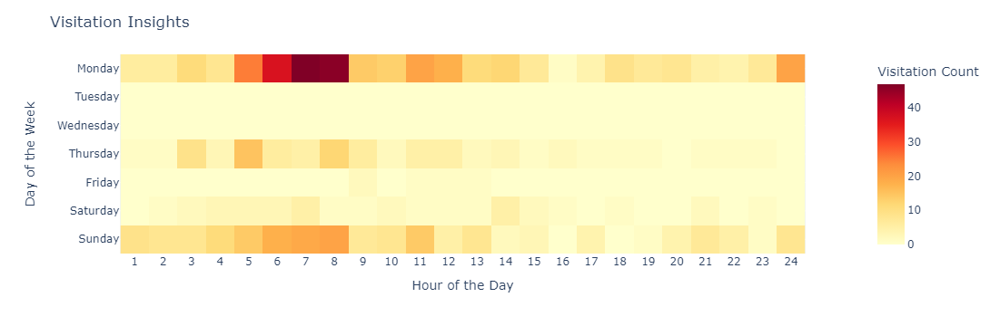

In [30]:
heatmap_data = pandas_df.pivot_table(index='day_name', columns='hour', aggfunc='size')

# Reorder the rows of the heatmap data to match the order in the image
heatmap_data = heatmap_data.reindex(['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday'])

# Create the heatmap using Plotly Express
fig = px.imshow(heatmap_data,
                labels=dict(x="Hour of the Day", y="Day of the Week", color="Visitation Count"),
                x=['1', '2', '3', '4', '5', '6', '7', '8', '9', '10', '11', '12', '13', '14', '15', '16', '17', '18', '19', '20', '21', '22', '23', '24'],
                y=['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday'],
                color_continuous_scale="YlOrRd")

# Update layout
fig.update_layout(title='Visitation Insights',
                  xaxis_title='Hour of the Day',
                  yaxis_title='Day of the Week')

# Show the plot
fig.show()

## Spend Time

In [33]:
count_within_radius_df.select('maid','day','hour').orderBy('maid','day','hour').show(5,truncate=False)

+------------------------------------+---+----+
|maid                                |day|hour|
+------------------------------------+---+----+
|020bc715-32dc-43bd-84f7-1a5898f84ac0|18 |0   |
|020bc715-32dc-43bd-84f7-1a5898f84ac0|18 |7   |
|020bc715-32dc-43bd-84f7-1a5898f84ac0|18 |10  |
|020bc715-32dc-43bd-84f7-1a5898f84ac0|18 |13  |
|02a1a461-8cab-4cdf-9a09-37a16ae35529|18 |5   |
+------------------------------------+---+----+
only showing top 5 rows



In [41]:
from pyspark.sql.functions import unix_timestamp, col

hour_difference_df = count_within_radius_df.groupBy('maid', 'day').agg(
    (F.max(unix_timestamp('datetimestamp')) - F.min(unix_timestamp('datetimestamp'))).alias('hour_difference')
)
hour_difference_df = hour_difference_df.withColumn('hour_difference', col('hour_difference') / 3600) # Convert seconds to hours

hour_difference_df=hour_difference_df.where(hour_difference_df['hour_difference'] > 0).orderBy(('hour_difference'))
hour_difference_df.show(5)
hour_difference_df.count()

+--------------------+---+--------------------+
|                maid|day|     hour_difference|
+--------------------+---+--------------------+
|090996f1-d7b3-46e...| 17|2.777777777777778E-4|
|24bf9684-1005-48f...| 17|2.777777777777778E-4|
|6676480f-7e1c-4b8...| 17|2.777777777777778E-4|
|61f3b64f-418a-4d8...| 16|0.001944444444444...|
|a06caf2c-310a-4b5...| 18|0.002777777777777778|
+--------------------+---+--------------------+
only showing top 5 rows



136

C:\Users\tuanm\AppData\Local\Temp\ipykernel_8664\2181547074.py:10: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.



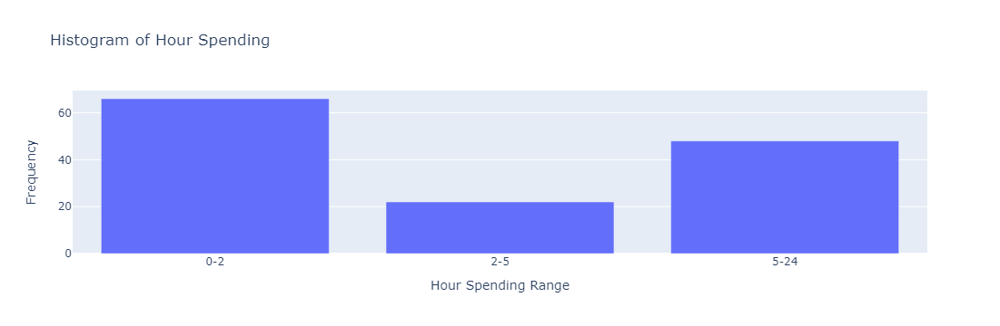

In [47]:
hour_difference_pandas = hour_difference_df.select('hour_difference').toPandas()

# Define bin edges
bin_edges = [0, 2, 5, 24]

# Categorize minute differences into bins
hour_difference_pandas['bin'] = pd.cut(hour_difference_pandas['hour_difference'], bins=bin_edges, labels=['0-2', '2-5', '5-24'])

# Aggregate counts by bin
agg_df = hour_difference_pandas.groupby('bin').size().reset_index(name='count')

# Create histogram using Plotly Express
histogram_fig = px.bar(agg_df, x='bin', y='count', 
                       title='Histogram of Hour Spending',
                       labels={'bin': 'Hour Spending Range', 'count': 'Frequency'})

# Show plot
histogram_fig.show()

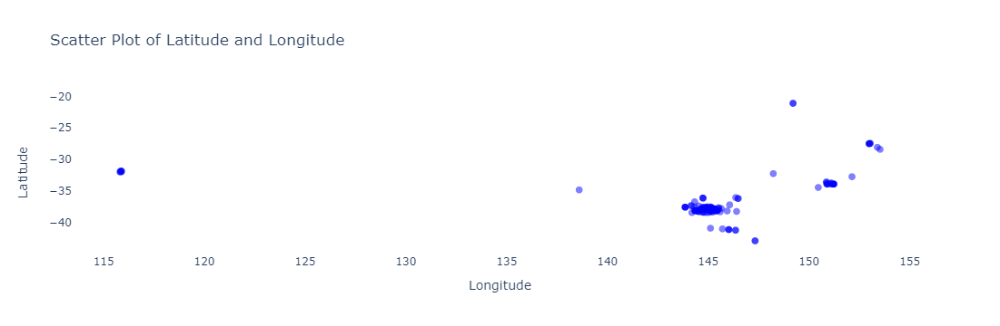

In [87]:
count_within_radius_df_filtered = df.join(count_within_radius_df, on='maid', how='left_semi')
lon_lat=count_within_radius_df_filtered.select('latitude','longitude').orderBy('maid')
lon_lat=lon_lat.toPandas()
lon_lat = lon_lat.sample(frac=1).reset_index(drop=True)  # Shuffle the DataFrame for better visualization
# Create a scatter plot using Plotly Express
fig = px.scatter(lon_lat, x='longitude', y='latitude', title='Scatter Plot of Latitude and Longitude')
fig.update_traces(marker=dict(size=8, opacity=0.5, color='blue'))
fig.update_layout(xaxis_title='Longitude', yaxis_title='Latitude', plot_bgcolor='rgba(0,0,0,0)')
fig.show()

In [49]:
count_within_radius_df_filtered.count()

1521

In [86]:
from math import radians, sin, cos, sqrt, atan2

def haversine(lat1, lon1, lat2, lon2):
    R = 6371  # Radius of the Earth in kilometers

    # Convert latitude and longitude from degrees to radians
    lat1, lon1, lat2, lon2 = map(radians, [lat1, lon1, lat2, lon2])

    # Calculate differences
    dlat = lat2 - lat1
    dlon = lon2 - lon1

    # Haversine formula
    a = sin(dlat / 2) ** 2 + cos(lat1) * cos(lat2) * sin(dlon / 2) ** 2
    c = 2 * atan2(sqrt(a), sqrt(1 - a))

    # Distance in kilometers
    distance = R * c*1000
    return distance

# Collect latitude and longitude values from the DataFrame
coordinates = count_within_radius_df_filtered.select('latitude', 'longitude').collect()

# Convert list of Row objects to Pandas DataFrame
coordinates_df = pd.DataFrame(coordinates, columns=['latitude', 'longitude'])

# Create a Folium map centered at the first coordinate
mymap_filtered = folium.Map(location=[user_lat, user_lon], zoom_start=10)

# Define he radius of the circle
circle_radius = 5000  # in meters
# Add markers for all coordinates to the map
for _, row in coordinates_df.iterrows():
    # Calculate the distance from the user's location to the current point
    distance = haversine(user_lat, user_lon, row['latitude'], row['longitude'])
    if distance <= circle_radius:
        # Add marker inside the circle with blue color
        folium.CircleMarker(location=[row['latitude'], row['longitude']], radius=2, color='blue', fill=True, fill_color='blue',
                            fill_opacity=1).add_to(mymap_filtered)
    else:
        # Add marker outside the circle with orange color
        folium.CircleMarker(location=[row['latitude'], row['longitude']], radius=2, color='brown', fill=True, fill_color='brown',fill_opacity=1).add_to(mymap_filtered)

# Add the user's location marker
folium.Marker(location=[user_lat, user_lon], radius=4, color='red', fill=True, fill_color='red',
                    fill_opacity=1).add_to(mymap_filtered)

# Add the circle representing the radius
folium.Circle(location=(user_lat, user_lon), radius=circle_radius, color='green', fill=True, fill_opacity=0.4).add_to(mymap_filtered)

# Display the map
mymap_filtered